In [35]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import numpy as np
import pandas as pd

import matplotlib
import matplotlib.pyplot as plt
import plotly
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

from ipywidgets import widgets
from tkinter import Tk
from tkinter import filedialog as fd

from sklearn.preprocessing import StandardScaler
from scipy.spatial import distance
from copy import deepcopy

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

        

In [36]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% ! important; }<style>"))

C:\Users\Orest\AppData\Local\Temp\ipykernel_4020\2348643420.py:1: DeprecationWarning:

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display



# Data analysis

In [37]:
def plot_genre_horizontal_bar(df, col, title=None):
    plt.style.use('default')
    data = df.groupby('genre')[col].mean().sort_values()

    cmap = plt.cm.coolwarm_r
    norm = plt.Normalize(vmin=data.min(), vmax=data.max())
    colors = [cmap(norm(value)) for value in data]

    data.plot.barh(color=colors)
    plt.xlabel(col)
    plt.title(title, fontdict={'size': 18, 'color': '#de5d83'})
    plt.show()

## Data Loading

In [38]:
data = pd.read_csv('genres_v2.csv')

C:\Users\Orest\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3134: DtypeWarning:

Columns (19) have mixed types.Specify dtype option on import or set low_memory=False.



In [39]:
data.head(10)

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,...,id,uri,track_href,analysis_url,duration_ms,time_signature,genre,song_name,Unnamed: 0,title
0,0.831,0.814,2,-7.364,1,0.4200,0.0598,0.013400,0.0556,0.3890,...,2Vc6NJ9PW9gD9q343XFRKx,spotify:track:2Vc6NJ9PW9gD9q343XFRKx,https://api.spotify.com/v1/tracks/2Vc6NJ9PW9gD...,https://api.spotify.com/v1/audio-analysis/2Vc6...,124539,4,Dark Trap,Mercury: Retrograde,NaN,NaN
1,0.719,0.493,8,-7.230,1,0.0794,0.4010,0.000000,0.1180,0.1240,...,7pgJBLVz5VmnL7uGHmRj6p,spotify:track:7pgJBLVz5VmnL7uGHmRj6p,https://api.spotify.com/v1/tracks/7pgJBLVz5Vmn...,https://api.spotify.com/v1/audio-analysis/7pgJ...,224427,4,Dark Trap,Pathology,NaN,NaN
2,0.850,0.893,5,-4.783,1,0.0623,0.0138,0.000004,0.3720,0.0391,...,0vSWgAlfpye0WCGeNmuNhy,spotify:track:0vSWgAlfpye0WCGeNmuNhy,https://api.spotify.com/v1/tracks/0vSWgAlfpye0...,https://api.spotify.com/v1/audio-analysis/0vSW...,98821,4,Dark Trap,Symbiote,NaN,NaN
3,0.476,0.781,0,-4.710,1,0.1030,0.0237,0.000000,0.1140,0.1750,...,0VSXnJqQkwuH2ei1nOQ1nu,spotify:track:0VSXnJqQkwuH2ei1nOQ1nu,https://api.spotify.com/v1/tracks/0VSXnJqQkwuH...,https://api.spotify.com/v1/audio-analysis/0VSX...,123661,3,Dark Trap,ProductOfDrugs (Prod. The Virus and Antidote),NaN,NaN
4,0.798,0.624,2,-7.668,1,0.2930,0.2170,0.000000,0.1660,0.5910,...,4jCeguq9rMTlbMmPHuO7S3,spotify:track:4jCeguq9rMTlbMmPHuO7S3,https://api.spotify.com/v1/tracks/4jCeguq9rMTl...,https://api.spotify.com/v1/audio-analysis/4jCe...,123298,4,Dark Trap,Venom,NaN,NaN
5,0.721,0.568,0,-11.295,1,0.4140,0.0452,0.212000,0.1280,0.1090,...,6fsypiJHyWmeINsOLC1cos,spotify:track:6fsypiJHyWmeINsOLC1cos,https://api.spotify.com/v1/tracks/6fsypiJHyWme...,https://api.spotify.com/v1/audio-analysis/6fsy...,112511,4,Dark Trap,Gatteka,NaN,NaN
6,0.718,0.668,8,-4.162,1,0.1370,0.0254,0.007800,0.1240,0.0380,...,0XfQbq7DaMOmVXgQ71eA6E,spotify:track:0XfQbq7DaMOmVXgQ71eA6E,https://api.spotify.com/v1/tracks/0XfQbq7DaMOm...,https://api.spotify.com/v1/audio-analysis/0XfQ...,77584,4,Dark Trap,kamikaze (+ pulse),NaN,NaN
7,0.694,0.711,8,-5.525,1,0.2210,0.0397,0.000000,0.1120,0.2830,...,0LLeuNBWPOg3XA73yab3PT,spotify:track:0LLeuNBWPOg3XA73yab3PT,https://api.spotify.com/v1/tracks/0LLeuNBWPOg3...,https://api.spotify.com/v1/audio-analysis/0LLe...,127524,3,Dark Trap,T.R.U. (Totally Rotten Underground),NaN,NaN
8,0.774,0.751,1,-2.445,1,0.1980,0.0614,0.000000,0.0728,0.1890,...,37gqBnUAZe8BY8WR56kDNk,spotify:track:37gqBnUAZe8BY8WR56kDNk,https://api.spotify.com/v1/tracks/37gqBnUAZe8B...,https://api.spotify.com/v1/audio-analysis/37gq...,140326,4,Dark Trap,I Put My Dick in Your Mental,NaN,NaN
9,0.893,0.907,11,-10.406,1,0.3670,0.1520,0.031100,0.5580,0.3020,...,2ggqfj97qyiORmXoVFzP5j,spotify:track:2ggqfj97qyiORmXoVFzP5j,https://api.spotify.com/v1/tracks/2ggqfj97qyiO...,https://api.spotify.com/v1/audio-analysis/2ggq...,121979,4,Dark Trap,Andromeda,NaN,NaN


In [40]:
data.columns

Index(['danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo',
       'type', 'id', 'uri', 'track_href', 'analysis_url', 'duration_ms',
       'time_signature', 'genre', 'song_name', 'Unnamed: 0', 'title'],
      dtype='object')

In [41]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42305 entries, 0 to 42304
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   danceability      42305 non-null  float64
 1   energy            42305 non-null  float64
 2   key               42305 non-null  int64  
 3   loudness          42305 non-null  float64
 4   mode              42305 non-null  int64  
 5   speechiness       42305 non-null  float64
 6   acousticness      42305 non-null  float64
 7   instrumentalness  42305 non-null  float64
 8   liveness          42305 non-null  float64
 9   valence           42305 non-null  float64
 10  tempo             42305 non-null  float64
 11  type              42305 non-null  object 
 12  id                42305 non-null  object 
 13  uri               42305 non-null  object 
 14  track_href        42305 non-null  object 
 15  analysis_url      42305 non-null  object 
 16  duration_ms       42305 non-null  int64 

In [42]:
data.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,Unnamed: 0
count,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,20780.000000
mean,0.639364,0.762516,5.370240,-6.465442,0.549462,0.136561,0.096160,0.283048,0.214079,0.357101,147.474056,250865.846685,3.972580,10483.970645
std,0.156617,0.183823,3.666145,2.941165,0.497553,0.126168,0.170827,0.370791,0.175576,0.233200,23.844623,102957.713571,0.268342,6052.359519
min,0.065100,0.000243,0.000000,-33.357000,0.000000,0.022700,0.000001,0.000000,0.010700,0.018700,57.967000,25600.000000,1.000000,0.000000
25%,0.524000,0.632000,1.000000,-8.161000,0.000000,0.049100,0.001730,0.000000,0.099600,0.161000,129.931000,179840.000000,4.000000,5255.750000
50%,0.646000,0.803000,6.000000,-6.234000,1.000000,0.075500,0.016400,0.005940,0.135000,0.322000,144.973000,224760.000000,4.000000,10479.500000
75%,0.766000,0.923000,9.000000,-4.513000,1.000000,0.193000,0.107000,0.722000,0.294000,0.522000,161.464000,301133.000000,4.000000,15709.250000
max,0.988000,1.000000,11.000000,3.148000,1.000000,0.946000,0.988000,0.989000,0.988000,0.988000,220.290000,913052.000000,5.000000,20999.000000


## Data Distribution

In [43]:
numerical_cols = data.select_dtypes('number').columns.to_list()

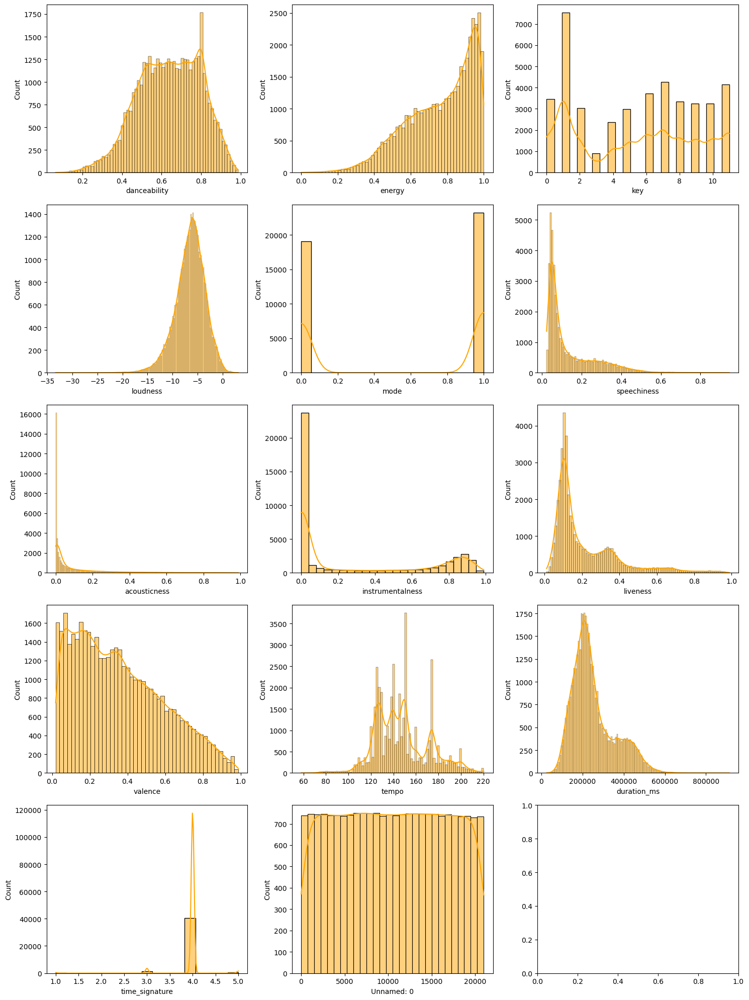

In [44]:
fig, axs = plt.subplots(nrows=5, ncols=3, figsize=(15,20))
axs = np.ravel(axs)

for i, col in enumerate(numerical_cols):
    plt.sca(axs[i])
    sns.histplot(data=data, x=col, kde=True, fill=True, color='orange')

plt.tight_layout()
plt.show()

## Data Dependencies

In [45]:
attr_to_del = list(data.columns[11:])
del attr_to_del[5]
del attr_to_del[6]
attr_to_del

['type',
 'id',
 'uri',
 'track_href',
 'analysis_url',
 'time_signature',
 'song_name',
 'Unnamed: 0',
 'title']

In [46]:
data.columns[11:]

Index(['type', 'id', 'uri', 'track_href', 'analysis_url', 'duration_ms',
       'time_signature', 'genre', 'song_name', 'Unnamed: 0', 'title'],
      dtype='object')

In [47]:
data_plot = deepcopy(data)
data_plot.drop(columns=attr_to_del, inplace=True)

In [48]:
data_plot.head(10)

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,genre
0,0.831,0.814,2,-7.364,1,0.4200,0.0598,0.013400,0.0556,0.3890,156.985,124539,Dark Trap
1,0.719,0.493,8,-7.230,1,0.0794,0.4010,0.000000,0.1180,0.1240,115.080,224427,Dark Trap
2,0.850,0.893,5,-4.783,1,0.0623,0.0138,0.000004,0.3720,0.0391,218.050,98821,Dark Trap
3,0.476,0.781,0,-4.710,1,0.1030,0.0237,0.000000,0.1140,0.1750,186.948,123661,Dark Trap
4,0.798,0.624,2,-7.668,1,0.2930,0.2170,0.000000,0.1660,0.5910,147.988,123298,Dark Trap
5,0.721,0.568,0,-11.295,1,0.4140,0.0452,0.212000,0.1280,0.1090,144.915,112511,Dark Trap
6,0.718,0.668,8,-4.162,1,0.1370,0.0254,0.007800,0.1240,0.0380,130.826,77584,Dark Trap
7,0.694,0.711,8,-5.525,1,0.2210,0.0397,0.000000,0.1120,0.2830,138.049,127524,Dark Trap
8,0.774,0.751,1,-2.445,1,0.1980,0.0614,0.000000,0.0728,0.1890,219.960,140326,Dark Trap
9,0.893,0.907,11,-10.406,1,0.3670,0.1520,0.031100,0.5580,0.3020,199.942,121979,Dark Trap


In [49]:
sns.set(style='ticks', context='talk')
plt.style.use("dark_background")

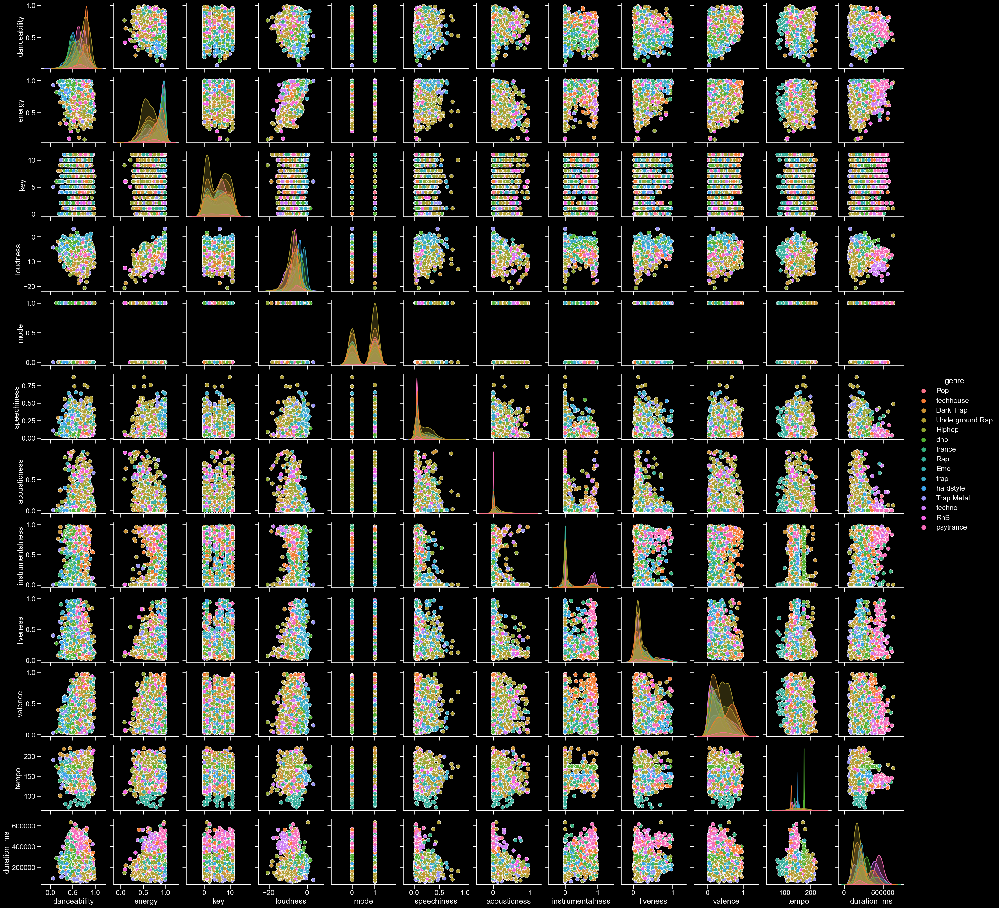

In [50]:
sns.pairplot(data_plot.sample(2000), corner=False, hue='genre')

<IPython.core.display.Javascript object>


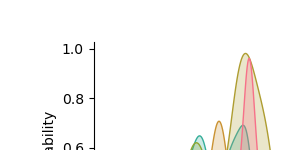

In [51]:
plt.style.use('default')
%matplotlib notebook
sns.pairplot(data = data_plot.sample(2000), corner=False, hue='genre')

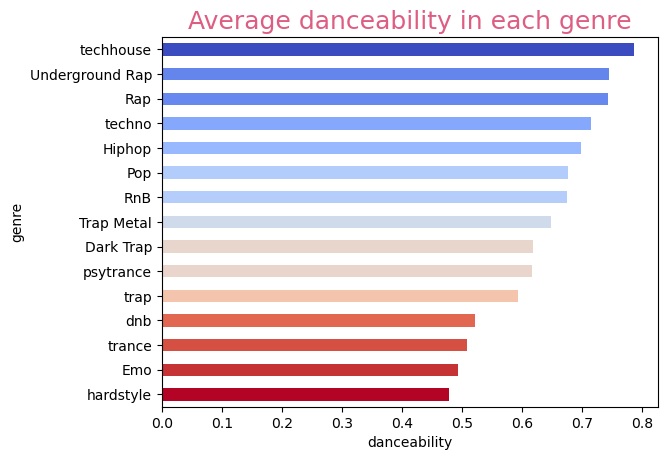

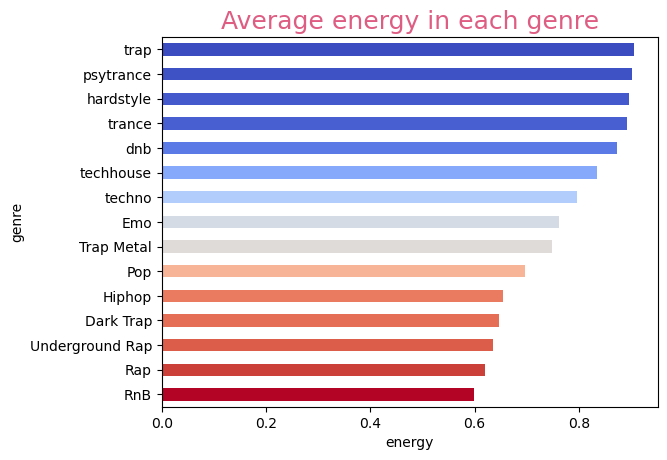

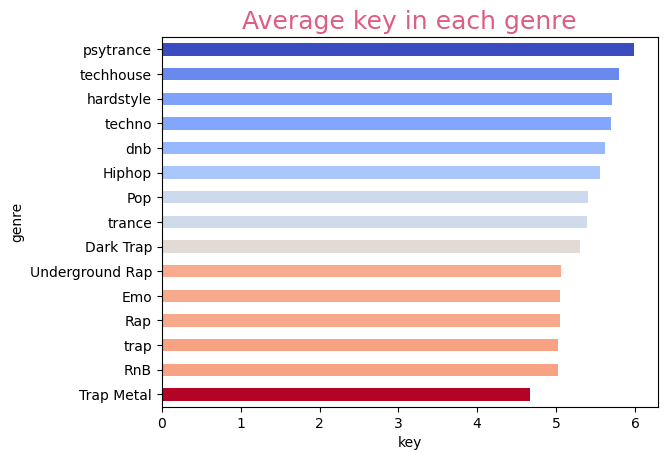

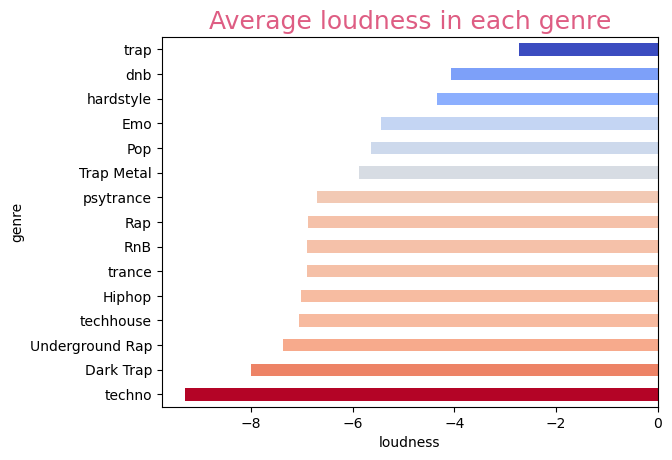

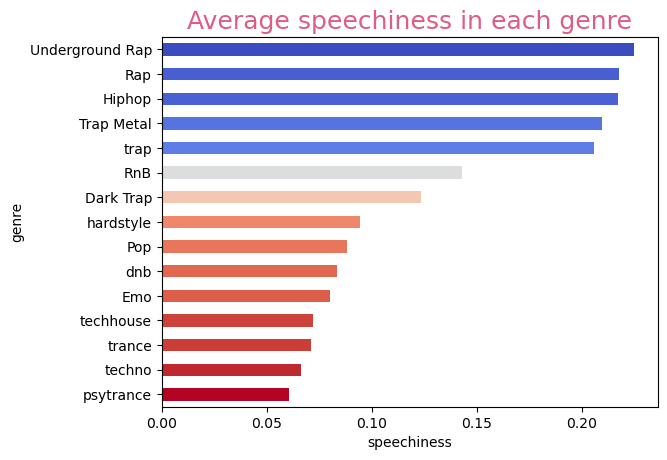

...

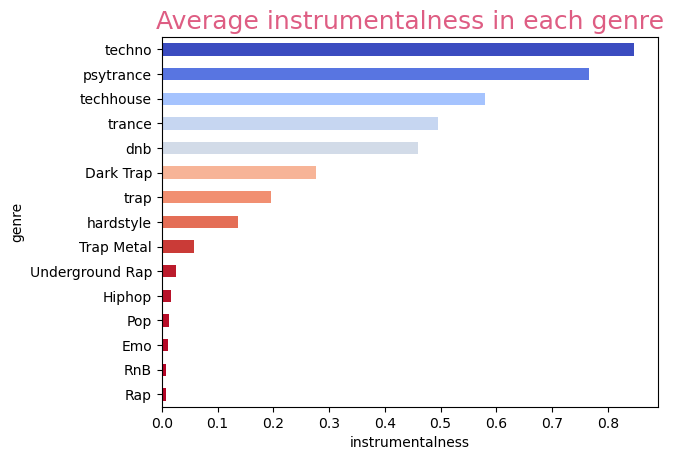

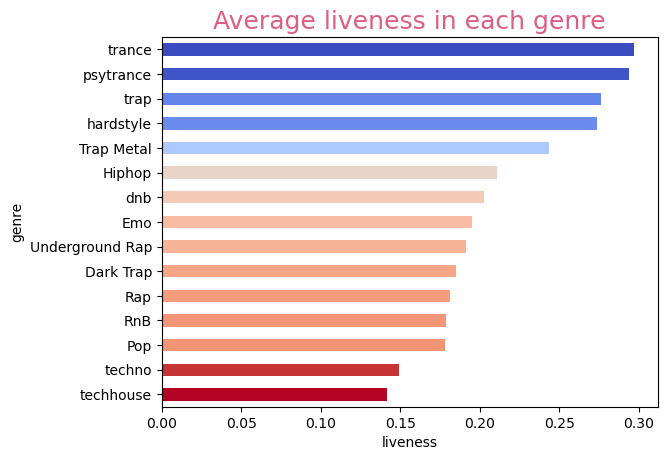

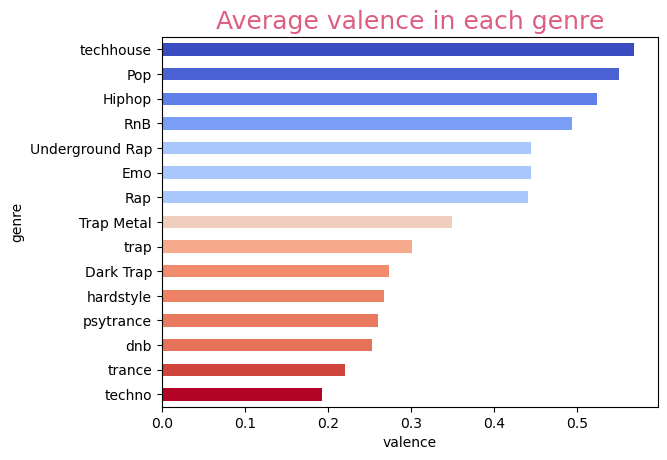

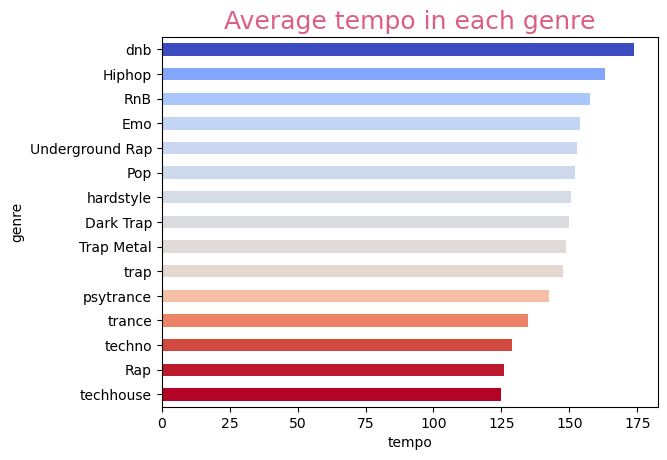

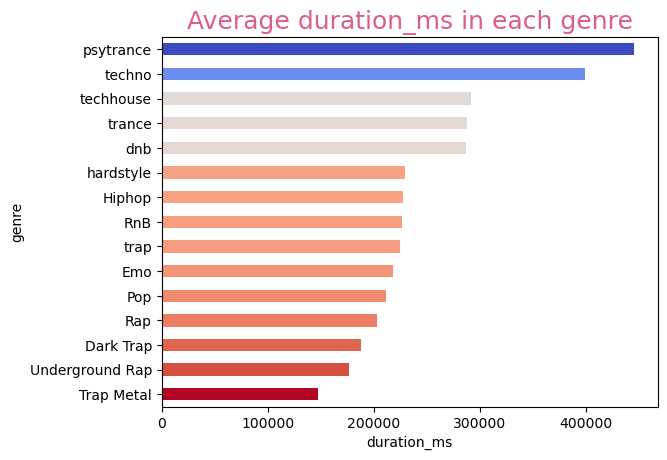

In [52]:
%matplotlib inline
for var in list(data_plot.columns[0:]):
    if(var != 'time_signature' and var != 'genre' and var != 'mode'):
        fig = px.box(data_frame=data, y=var, color='genre')
        
        plot_genre_horizontal_bar(data, var, title="Average " + var + " in each genre")
        fig.show()

In [53]:
data_mode = (data
        .groupby(['genre', 'mode'])['mode']
        .count()
        .unstack(1))

data_mode.style.background_gradient(cmap=plt.cm.coolwarm_r)

mode,0,1
genre,,
Dark Trap,2122,2456
Emo,528,1152
Hiphop,1430,1598
Pop,208,253
Rap,883,965
RnB,982,1117
Trap Metal,552,1404
Underground Rap,2270,3605
dnb,1643,1323


In [54]:
data_time_sign = (data
        .groupby(['genre', 'time_signature'])['time_signature']
        .count()
        .unstack(1))

data_time_sign.style.background_gradient(cmap=plt.cm.coolwarm_r)

time_signature,1,3,4,5
genre,,,,
Dark Trap,37.000000,181.000000,4245.000000,115.000000
Emo,8.000000,92.000000,1567.000000,13.000000
Hiphop,23.000000,64.000000,2882.000000,59.000000
Pop,2.000000,6.000000,448.000000,5.000000
Rap,7.000000,46.000000,1754.000000,41.000000
RnB,15.000000,90.000000,1941.000000,53.000000
Trap Metal,8.000000,115.000000,1785.000000,48.000000
Underground Rap,23.000000,159.000000,5583.000000,110.000000
dnb,1.000000,3.000000,2961.000000,1.000000


## Correlation

In [55]:
data.drop('Unnamed: 0', axis=1, inplace=True)

In [56]:
data.corr()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
danceability,1.000000,-0.323248,-0.012708,-0.216776,0.084413,0.182177,0.069910,-0.067114,-0.196702,0.369845,-0.165929,-0.049807,0.057711
energy,-0.323248,1.000000,0.044731,0.601540,-0.032203,-0.148363,-0.497334,0.303875,0.231754,-0.013520,-0.024504,0.294464,0.039781
key,-0.012708,0.044731,1.000000,-0.006810,-0.248283,-0.030634,-0.004937,0.068266,0.002753,0.028600,-0.009862,0.069255,0.008061
loudness,-0.216776,0.601540,-0.006810,1.000000,-0.004744,0.048035,-0.283876,-0.187933,0.167104,0.080916,0.151610,-0.095999,0.047471
mode,0.084413,-0.032203,-0.248283,-0.004744,1.000000,0.050260,-0.014514,-0.016402,0.007280,0.022208,-0.012191,-0.031253,-0.009317
speechiness,0.182177,-0.148363,-0.030634,0.048035,0.050260,1.000000,0.160184,-0.386571,0.057432,0.218829,0.164674,-0.309892,0.021637
acousticness,0.069910,-0.497334,-0.004937,-0.283876,-0.014514,0.160184,1.000000,-0.261896,-0.107229,0.099328,0.055643,-0.246681,-0.049791
instrumentalness,-0.067114,0.303875,0.068266,-0.187933,-0.016402,-0.386571,-0.261896,1.000000,-0.015990,-0.257068,-0.207667,0.603784,-0.010164
liveness,-0.196702,0.231754,0.002753,0.167104,0.007280,0.057432,-0.107229,-0.015990,1.000000,-0.025156,0.028327,0.010594,0.003077
valence,0.369845,-0.013520,0.028600,0.080916,0.022208,0.218829,0.099328,-0.257068,-0.025156,1.000000,0.058374,-0.191093,0.040308


In [57]:
x = list(data.corr().columns)
y = list(data.corr().index)
values = np.array(data.corr().values)
fig = go.Figure(data=go.Heatmap(z=values, x=x, y=y, hoverongaps=False))
fig.show()

# Classification

## EDA

In [58]:
print(f'There are {data.shape[0]} rows and {data.shape[1]} columns in dataset.\n')
data.isnull().sum() 

There are 42305 rows and 21 columns in dataset.



danceability            0
energy                  0
key                     0
loudness                0
mode                    0
speechiness             0
acousticness            0
instrumentalness        0
liveness                0
valence                 0
tempo                   0
type                    0
id                      0
uri                     0
track_href              0
analysis_url            0
duration_ms             0
time_signature          0
genre                   0
song_name           20786
title               21525
dtype: int64

In [59]:
print(f"Number of genres in given dataset: {len(data['genre'].unique())}\n")
data["genre"].unique()

Number of genres in given dataset: 15



array(['Dark Trap', 'Underground Rap', 'Trap Metal', 'Emo', 'Rap', 'RnB',
       'Pop', 'Hiphop', 'techhouse', 'techno', 'trance', 'psytrance',
       'trap', 'dnb', 'hardstyle'], dtype=object)

In [60]:
data['genre'].value_counts()

Underground Rap    5875
Dark Trap          4578
Hiphop             3028
trance             2999
trap               2987
techhouse          2975
dnb                2966
psytrance          2961
techno             2956
hardstyle          2936
RnB                2099
Trap Metal         1956
Rap                1848
Emo                1680
Pop                 461
Name: genre, dtype: int64

In [61]:
# Count of each genre
import plotly.express as px
px.histogram(data.genre)

In [62]:
data_genre = data['genre'].value_counts().head(10)
fig = px.pie(data_genre, names=data_genre.index, values=data_genre.values, title='Distribution of popular genre', labels=data_genre.index)
fig.show()

## Preprocess the Data

In [63]:
# Creating a new dataframe with required features
data_x = data[data.columns[:11]]
data_x.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
0,0.831,0.814,2,-7.364,1,0.4200,0.0598,0.013400,0.0556,0.3890,156.985
1,0.719,0.493,8,-7.230,1,0.0794,0.4010,0.000000,0.1180,0.1240,115.080
2,0.850,0.893,5,-4.783,1,0.0623,0.0138,0.000004,0.3720,0.0391,218.050
3,0.476,0.781,0,-4.710,1,0.1030,0.0237,0.000000,0.1140,0.1750,186.948
4,0.798,0.624,2,-7.668,1,0.2930,0.2170,0.000000,0.1660,0.5910,147.988


In [64]:
data_new = data_x.copy()
data_new['genre'] = data['genre']
data_new['time_signature'] = data['time_signature']
data_new['duration_ms'] = data['duration_ms']

data_new.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre,time_signature,duration_ms
0,0.831,0.814,2,-7.364,1,0.4200,0.0598,0.013400,0.0556,0.3890,156.985,Dark Trap,4,124539
1,0.719,0.493,8,-7.230,1,0.0794,0.4010,0.000000,0.1180,0.1240,115.080,Dark Trap,4,224427
2,0.850,0.893,5,-4.783,1,0.0623,0.0138,0.000004,0.3720,0.0391,218.050,Dark Trap,4,98821
3,0.476,0.781,0,-4.710,1,0.1030,0.0237,0.000000,0.1140,0.1750,186.948,Dark Trap,3,123661
4,0.798,0.624,2,-7.668,1,0.2930,0.2170,0.000000,0.1660,0.5910,147.988,Dark Trap,4,123298


In [65]:
data_new['duration_min'] = data_new['duration_ms']/60000
data_new.drop('duration_ms',axis=1,inplace=True)
data_new

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre,time_signature,duration_min
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,Dark Trap,4,2.075650
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,Dark Trap,4,3.740450
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,Dark Trap,4,1.647017
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,Dark Trap,3,2.061017
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,Dark Trap,4,2.054967
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,hardstyle,4,4.486800
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,hardstyle,4,3.501867
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,hardstyle,4,3.913717
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,hardstyle,4,5.386667


## Correlation analysys

In [66]:
# There is no highly correlated values - do not drop any features
from sklearn.preprocessing import LabelEncoder
data2Corr = data_new.copy()
data2Corr['genre'] = LabelEncoder().fit_transform(data2Corr['genre'])
corrMx = data2Corr.corr()
corrMx.style.background_gradient(cmap = "RdBu_r")

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre,time_signature,duration_min
danceability,1.000000,-0.323248,-0.012708,-0.216776,0.084413,0.182177,0.069910,-0.067114,-0.196702,0.369845,-0.165929,-0.052687,0.057711,-0.049807
energy,-0.323248,1.000000,0.044731,0.601540,-0.032203,-0.148363,-0.497334,0.303875,0.231754,-0.013520,-0.024504,0.471327,0.039781,0.294464
key,-0.012708,0.044731,1.000000,-0.006810,-0.248283,-0.030634,-0.004937,0.068266,0.002753,0.028600,-0.009862,0.027398,0.008061,0.069255
loudness,-0.216776,0.601540,-0.006810,1.000000,-0.004744,0.048035,-0.283876,-0.187933,0.167104,0.080916,0.151610,0.160771,0.047471,-0.095999
mode,0.084413,-0.032203,-0.248283,-0.004744,1.000000,0.050260,-0.014514,-0.016402,0.007280,0.022208,-0.012191,-0.019531,-0.009317,-0.031253
speechiness,0.182177,-0.148363,-0.030634,0.048035,0.050260,1.000000,0.160184,-0.386571,0.057432,0.218829,0.164674,-0.144596,0.021637,-0.309892
acousticness,0.069910,-0.497334,-0.004937,-0.283876,-0.014514,0.160184,1.000000,-0.261896,-0.107229,0.099328,0.055643,-0.356286,-0.049791,-0.246681
instrumentalness,-0.067114,0.303875,0.068266,-0.187933,-0.016402,-0.386571,-0.261896,1.000000,-0.015990,-0.257068,-0.207667,0.414434,-0.010164,0.603784
liveness,-0.196702,0.231754,0.002753,0.167104,0.007280,0.057432,-0.107229,-0.015990,1.000000,-0.025156,0.028327,0.107690,0.003077,0.010594
valence,0.369845,-0.013520,0.028600,0.080916,0.022208,0.218829,0.099328,-0.257068,-0.025156,1.000000,0.058374,-0.170698,0.040308,-0.191093


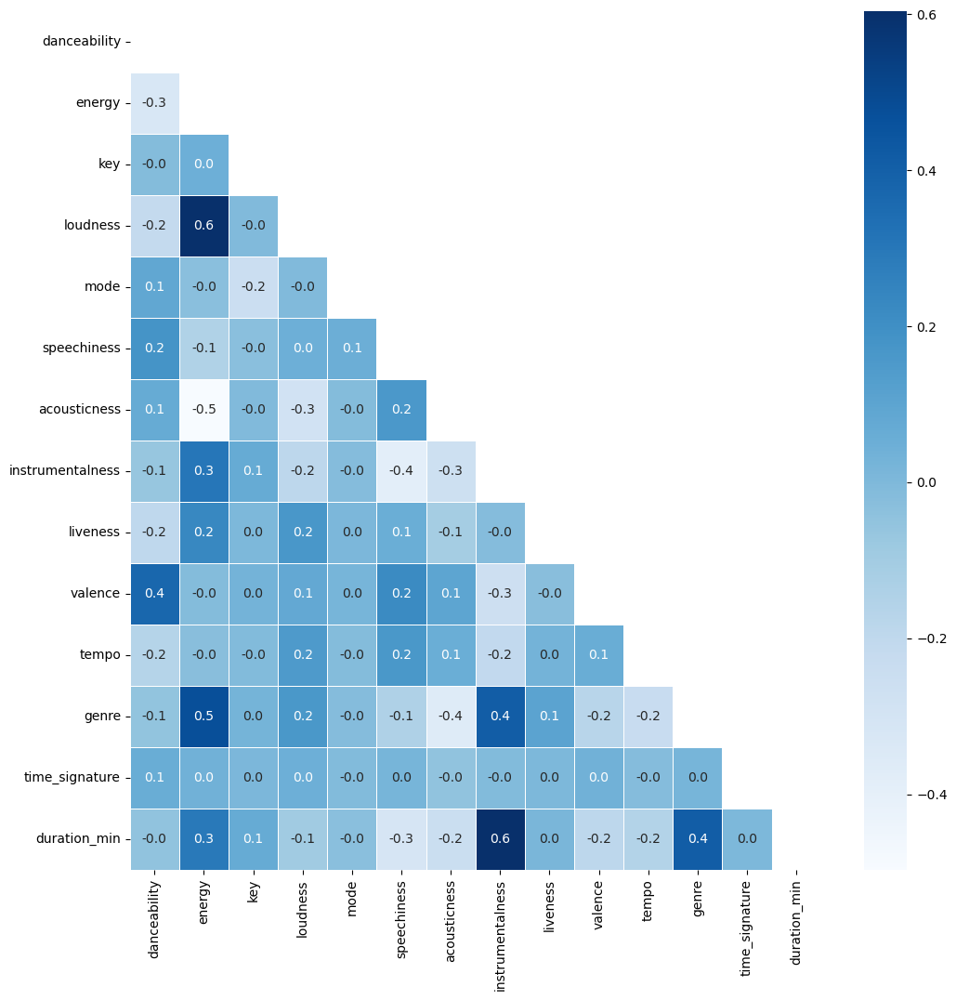

In [67]:
f,ax = plt.subplots(figsize=(12, 12))
mask = np.zeros_like(data2Corr.corr())
mask[np.triu_indices_from(mask)] = True
sns.heatmap(data2Corr.corr(), annot=True, linewidths=0.4,linecolor="white", fmt= '.1f',ax=ax,cmap="Blues",mask=mask)
plt.show() 

## Feature Scaling and Normalization

In [68]:
from sklearn.preprocessing import LabelEncoder
data_new['genre_enco'] = LabelEncoder().fit_transform(data_new['genre'])
data_new['genre_enco'].value_counts()

7     5875
0     4578
2     3028
13    2999
14    2987
11    2975
8     2966
10    2961
12    2956
9     2936
5     2099
6     1956
4     1848
1     1680
3      461
Name: genre_enco, dtype: int64

In [113]:
data_new['genre'].value_counts()

Underground Rap    5875
Dark Trap          4578
Hiphop             3028
trance             2999
trap               2987
techhouse          2975
dnb                2966
psytrance          2961
techno             2956
hardstyle          2936
RnB                2099
Trap Metal         1956
Rap                1848
Emo                1680
Pop                 461
Name: genre, dtype: int64

In [69]:
X1 = data_new.drop(columns=['genre','genre_enco'])
Y1 = data_new["genre_enco"]
print(X1.shape)

(42305, 13)


In [70]:
# feature scaling and normalization
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
X1_std = StandardScaler().fit_transform(X1)

## SMOTE

In [71]:
from imblearn.over_sampling import SMOTE

smote = SMOTE()
X1, Y1 = smote.fit_resample(X1_std, Y1)

print(X1.shape)

(88125, 13)


In [72]:
pd.DataFrame(X1)

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,1.223608,0.280079,-0.919298,-0.305514,0.905517,2.246552,-0.212853,-0.727231,-0.902637,0.136790,0.398876,0.102184,-1.226992
1,0.508480,-1.466185,0.717318,-0.259954,0.905517,-0.453057,1.784518,-0.763370,-0.547231,-0.999586,-1.358564,0.102184,-0.256796
2,1.344924,0.709845,-0.100990,0.572039,0.905517,-0.588592,-0.482135,-0.763359,0.899456,-1.363655,2.959861,0.102184,-1.476787
3,-1.043093,0.100557,-1.464837,0.596860,0.905517,-0.266002,-0.424181,-0.763370,-0.570013,-0.780887,1.655485,-3.624453,-1.235520
4,1.012900,-0.753535,-0.919298,-0.408876,0.905517,1.239945,0.707390,-0.763370,-0.273841,1.003008,0.021554,0.102184,-1.239046
...,...,...,...,...,...,...,...,...,...,...,...,...,...
88120,0.035001,0.591627,-1.192067,2.303868,-1.104341,-0.380292,-0.508767,-0.029529,0.763643,-0.719457,0.070627,0.102184,-0.628479
88121,0.145113,0.513472,1.283279,0.786289,-1.104341,-0.074208,-0.532796,-0.608150,2.545086,-1.160865,0.075656,0.102184,-0.406480
88122,0.623769,0.655019,-0.919654,1.230458,0.905517,0.289327,-0.457316,-0.667138,1.606351,0.076514,0.106984,0.102184,-0.554476
88123,-0.597517,1.081177,1.467322,0.638054,-1.104341,1.545052,-0.559774,0.362272,1.793286,-0.722719,0.103934,0.102184,-0.450977


In [74]:
fig = px.histogram(Y1)
fig.update_layout(bargap=0.2)
fig.show()

## Model

In [75]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from itertools import product
import time

In [76]:
X_train, X_test, y_train, y_test = train_test_split(X1, Y1, test_size=.2, random_state=1, shuffle=True)
print(X_train.shape)
print(X_test.shape)

(70500, 13)
(17625, 13)


In [77]:
scoring = [['model','accuracy']]

### Bulding models

In [78]:
def buildModel(model, X_train, X_test, y_train, y_test):
    model.fit(X_train, y_train)  # train model
    yhat = model.predict(X_test) # predict
    score = accuracy_score(y_test, yhat)
    return {
      "predict": yhat,
      "accuracy": score
    }

In [79]:
def modelCrossValidation(X, Y, algo):
    validation = KFold(n_splits=5, shuffle=True, random_state=1)
    statsNames = ['accuracy', 'balanced_accuracy', 'f1_weighted', 'f1_macro']

    res = {}
    for sname in statsNames:
        res[sname] = round(cross_val_score(algo, X, Y, cv=validation, scoring=sname, n_jobs=-1).mean(), 4)
    return res

### Feature Importance

[0.07627904 0.05666471 0.03245915 0.05923208 0.0452505  0.05147604
 0.0399186  0.17862207 0.02069121 0.05531263 0.22565117 0.02609495
 0.1323479 ]


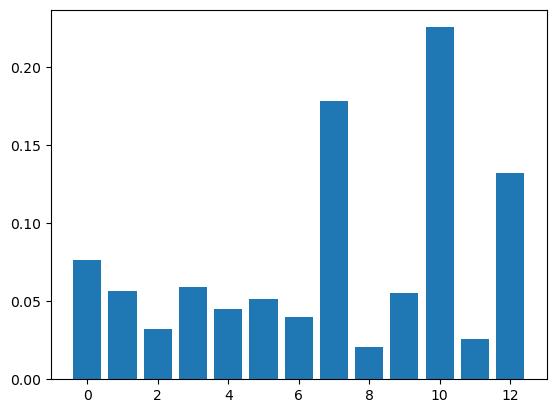

In [80]:
# plot feature importance manually
from numpy import loadtxt
from xgboost import XGBClassifier
from matplotlib import pyplot

# fit model no training data
model = XGBClassifier()
model.fit(X_train, y_train)

# feature importance
print(model.feature_importances_)

# plot
pyplot.bar(range(len(model.feature_importances_)), model.feature_importances_)
pyplot.show()

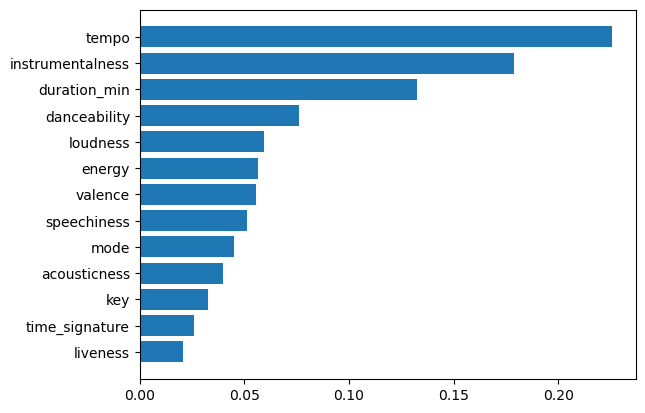

In [81]:
importance = model.feature_importances_
indices = np.argsort(importance)

fig, ax = plt.subplots()
ax.barh(range(len(importance)), importance[indices])
ax.set_yticks(range(len(importance)))
_ = ax.set_yticklabels(np.array(data_new.drop(columns=['genre','genre_enco']).columns)[indices])

## Model Selection

### LogisticRegression

In [82]:
# LogisticRegression
from sklearn.linear_model import LogisticRegression
model_LR = LogisticRegression(max_iter=1000);
res_LR = buildModel(model_LR, X_train, X_test, y_train, y_test)

print(res_LR["accuracy"])

0.5804255319148937


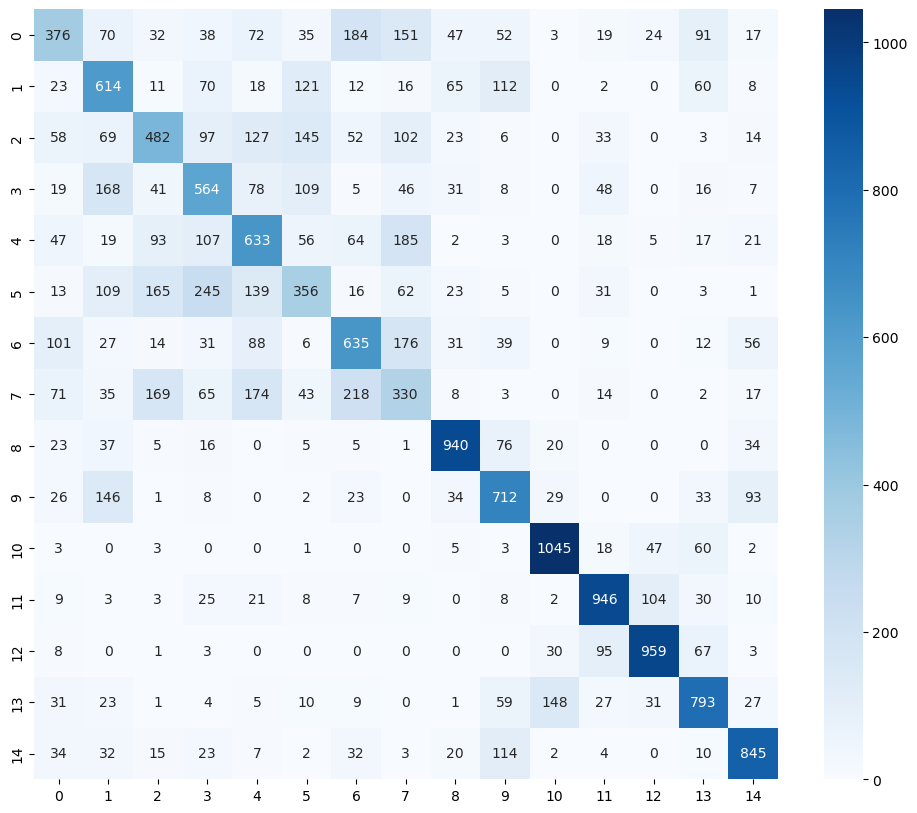

In [85]:
# y_pred = res_RF['predict']
cm = confusion_matrix(y_test, res_LR["predict"])
fig = plt.subplots(figsize=(12, 10))
ax = sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")

In [86]:
print(classification_report(y_test, res_LR["predict"]))

              precision    recall  f1-score   support

           0       0.45      0.31      0.37      1211
           1       0.45      0.54      0.49      1132
           2       0.47      0.40      0.43      1211
           3       0.44      0.49      0.46      1140
           4       0.46      0.50      0.48      1270
           5       0.40      0.30      0.34      1168
           6       0.50      0.52      0.51      1225
           7       0.31      0.29      0.30      1149
           8       0.76      0.81      0.79      1162
           9       0.59      0.64      0.62      1107
          10       0.82      0.88      0.85      1187
          11       0.75      0.80      0.77      1185
          12       0.82      0.82      0.82      1166
          13       0.66      0.68      0.67      1169
          14       0.73      0.74      0.74      1143

    accuracy                           0.58     17625
   macro avg       0.57      0.58      0.58     17625
weighted avg       0.57   

### Naive Bayes

In [87]:
# Naive Bayes
from sklearn.naive_bayes import GaussianNB
model_NB = GaussianNB()
res_NB = buildModel(model_NB, X_train, X_test, y_train, y_test)
print(res_NB["accuracy"])

0.5863829787234043


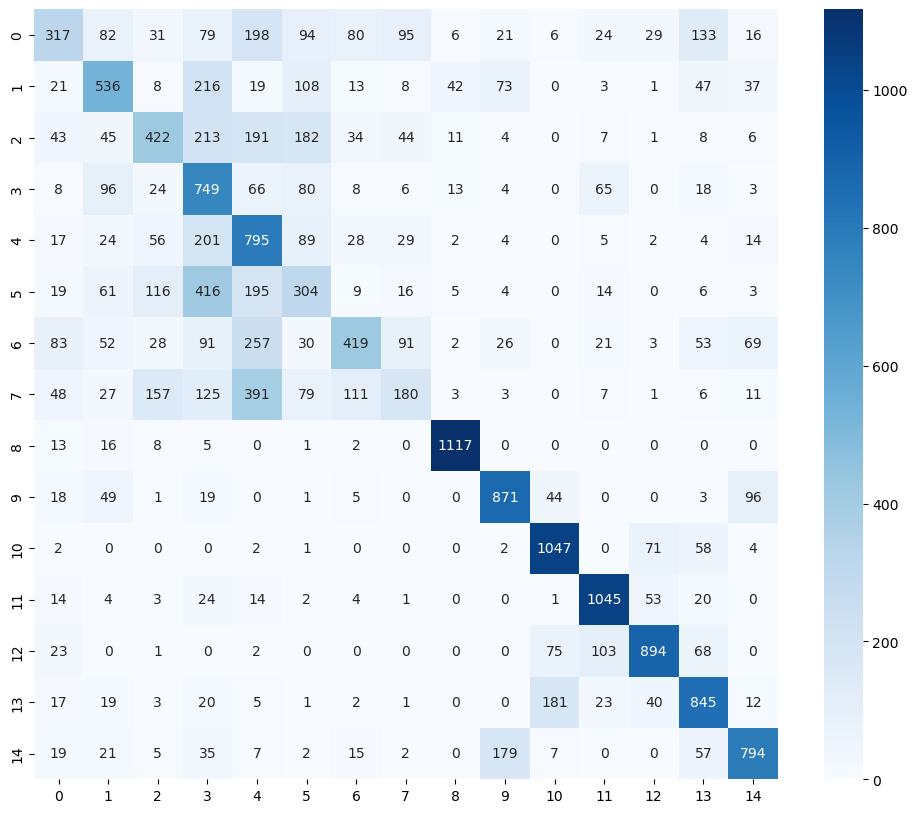

In [90]:
# y_pred = res_RF['predict']
cm = confusion_matrix(y_test, res_NB["predict"])
fig = plt.subplots(figsize=(12, 10))
ax = sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")

In [91]:
print(classification_report(y_test, res_NB["predict"]))

              precision    recall  f1-score   support

           0       0.48      0.26      0.34      1211
           1       0.52      0.47      0.50      1132
           2       0.49      0.35      0.41      1211
           3       0.34      0.66      0.45      1140
           4       0.37      0.63      0.47      1270
           5       0.31      0.26      0.28      1168
           6       0.57      0.34      0.43      1225
           7       0.38      0.16      0.22      1149
           8       0.93      0.96      0.95      1162
           9       0.73      0.79      0.76      1107
          10       0.77      0.88      0.82      1187
          11       0.79      0.88      0.84      1185
          12       0.82      0.77      0.79      1166
          13       0.64      0.72      0.68      1169
          14       0.75      0.69      0.72      1143

    accuracy                           0.59     17625
   macro avg       0.59      0.59      0.58     17625
weighted avg       0.59   

### K-Nearest Neighbors

In [92]:
# K-Nearest Neighbors
from sklearn.neighbors import KNeighborsClassifier
model_KNN = KNeighborsClassifier(n_neighbors=4) # n_neighbors=3
res_KNN = buildModel(model_KNN, X_train, X_test, y_train, y_test)

scoring.append(['KNeighbors', res_KNN["accuracy"]])
scoring[1]

['KNeighbors', 0.7775886524822695]

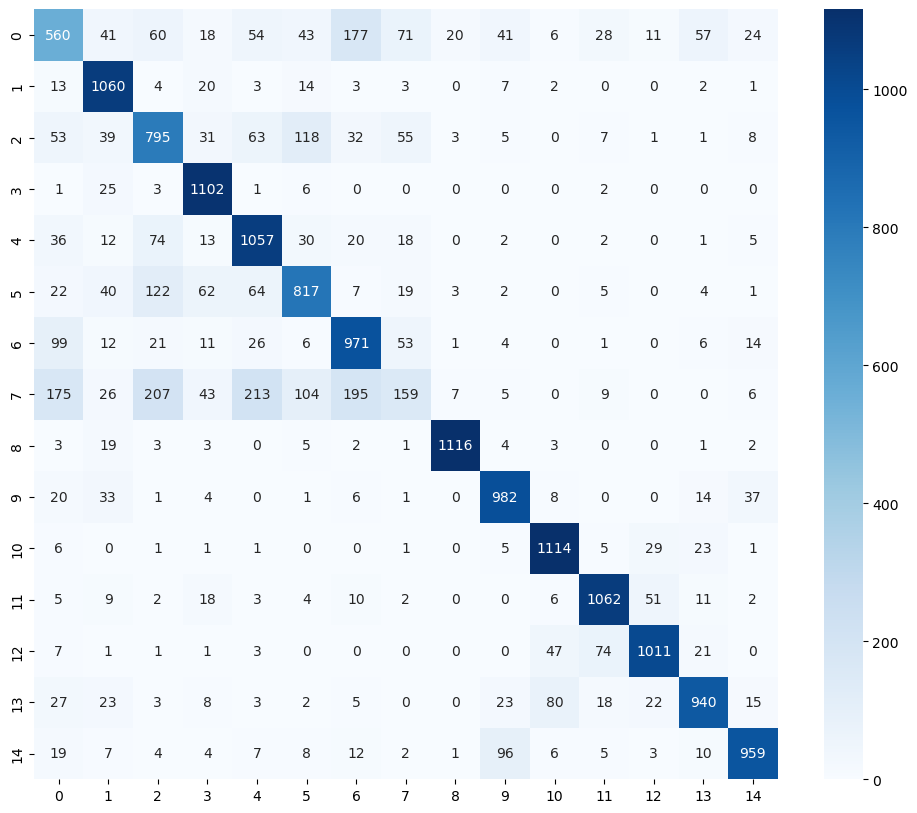

In [93]:
# y_pred = res_RF['predict']
cm = confusion_matrix(y_test, res_KNN["predict"])
fig = plt.subplots(figsize=(12, 10))
ax = sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")

In [94]:
print(classification_report(y_test, res_KNN["predict"]))

              precision    recall  f1-score   support

           0       0.54      0.46      0.50      1211
           1       0.79      0.94      0.86      1132
           2       0.61      0.66      0.63      1211
           3       0.82      0.97      0.89      1140
           4       0.71      0.83      0.76      1270
           5       0.71      0.70      0.70      1168
           6       0.67      0.79      0.73      1225
           7       0.41      0.14      0.21      1149
           8       0.97      0.96      0.96      1162
           9       0.84      0.89      0.86      1107
          10       0.88      0.94      0.91      1187
          11       0.87      0.90      0.88      1185
          12       0.90      0.87      0.88      1166
          13       0.86      0.80      0.83      1169
          14       0.89      0.84      0.86      1143

    accuracy                           0.78     17625
   macro avg       0.76      0.78      0.76     17625
weighted avg       0.76   

### Decision Tree

In [95]:
# Decision Tree
from sklearn.tree import DecisionTreeClassifier
model_DT = DecisionTreeClassifier(max_depth=10, min_samples_split=10, random_state=42)
res_DT = buildModel(model_DT, X_train, X_test, y_train, y_test)
print(res_DT["accuracy"])

0.6448794326241135


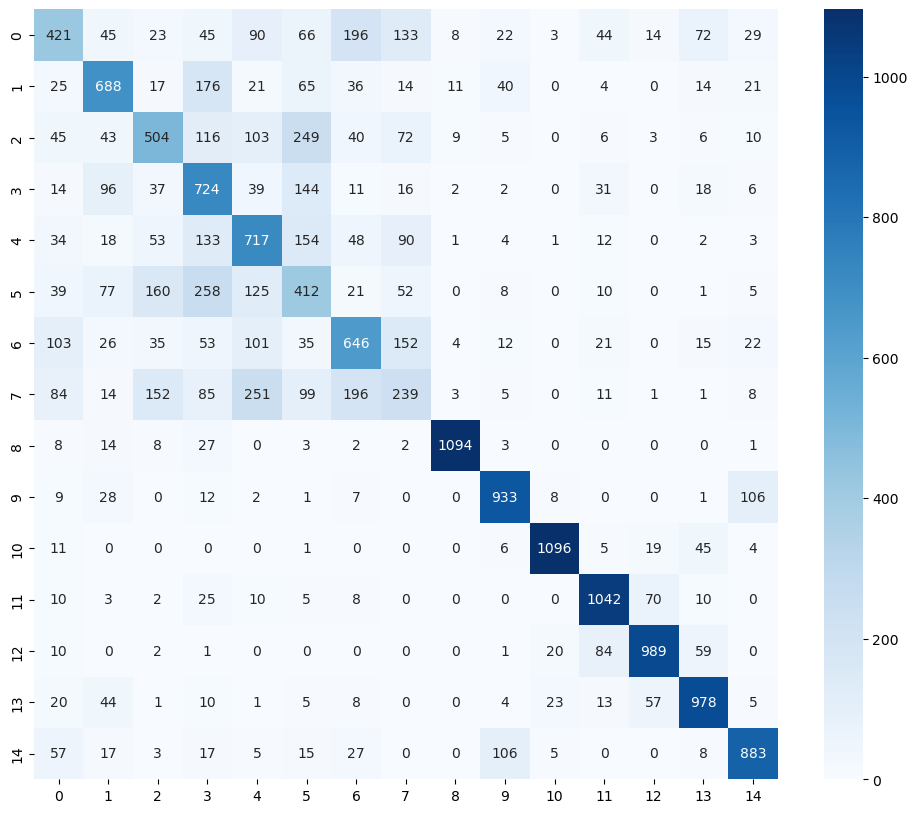

In [96]:
# y_pred = res_RF['predict']
cm = confusion_matrix(y_test, res_DT["predict"])
fig = plt.subplots(figsize=(12, 10))
ax = sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")

In [97]:
print(classification_report(y_test, res_DT["predict"]))

              precision    recall  f1-score   support

           0       0.47      0.35      0.40      1211
           1       0.62      0.61      0.61      1132
           2       0.51      0.42      0.46      1211
           3       0.43      0.64      0.51      1140
           4       0.49      0.56      0.52      1270
           5       0.33      0.35      0.34      1168
           6       0.52      0.53      0.52      1225
           7       0.31      0.21      0.25      1149
           8       0.97      0.94      0.95      1162
           9       0.81      0.84      0.83      1107
          10       0.95      0.92      0.94      1187
          11       0.81      0.88      0.84      1185
          12       0.86      0.85      0.85      1166
          13       0.80      0.84      0.82      1169
          14       0.80      0.77      0.79      1143

    accuracy                           0.64     17625
   macro avg       0.64      0.65      0.64     17625
weighted avg       0.64   

In [77]:
# get importance
importance = model_DT.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))

Feature: 0, Score: 0.09106
Feature: 1, Score: 0.05136
Feature: 2, Score: 0.00131
Feature: 3, Score: 0.04704
Feature: 4, Score: 0.00058
Feature: 5, Score: 0.04661
Feature: 6, Score: 0.01300
Feature: 7, Score: 0.09188
Feature: 8, Score: 0.00660
Feature: 9, Score: 0.04510
Feature: 10, Score: 0.45122
Feature: 11, Score: 0.00039
Feature: 12, Score: 0.15388


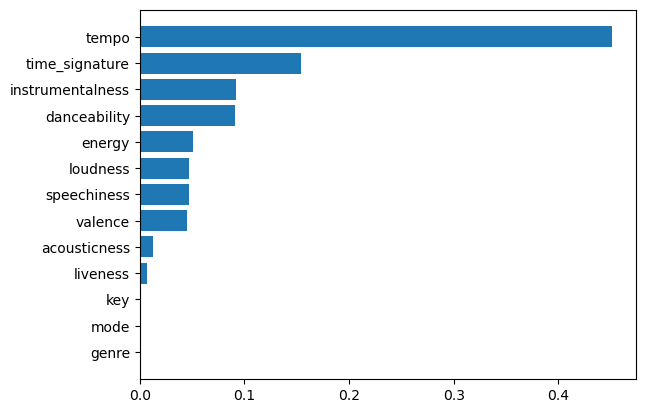

In [79]:
# plot feature importance
indices = np.argsort(importance)

fig, ax = plt.subplots()
ax.barh(range(len(importance)), importance[indices])
ax.set_yticks(range(len(importance)))
_ = ax.set_yticklabels(np.array(data_new.columns)[indices])

### Random Forest

In [102]:
# Random Forest
from sklearn.ensemble import RandomForestClassifier

# Train Accuracy 
k = 5
model_RF = RandomForestClassifier(n_estimators=200, max_depth=30, random_state=3)
cv_score = cross_val_score(model_RF, X_train, y_train, cv=k)
print('Cross_val Scores: ', cv_score)
print("Train Accuracy(average):", cv_score.mean())

# Test Accuracy
clf_RF = model_RF.fit(X_train, y_train)
RF_pred = clf_RF.predict(X_test)
score_accuracy = accuracy_score(y_test, RF_pred)
print("Test Accuracy:", score_accuracy)
scoring.append(['RandomForest', score_accuracy])

Cross_val Scores:  [0.80382979 0.80680851 0.80992908 0.80687943 0.81099291]
Train Accuracy(average): 0.8076879432624112
Test Accuracy: 0.8099290780141843


Feature: 0, Score: 0.09816
Feature: 1, Score: 0.07616
Feature: 2, Score: 0.03603
Feature: 3, Score: 0.08101
Feature: 4, Score: 0.01112
Feature: 5, Score: 0.07117
Feature: 6, Score: 0.06716
Feature: 7, Score: 0.09593
Feature: 8, Score: 0.05058
Feature: 9, Score: 0.07190
Feature: 10, Score: 0.20944
Feature: 11, Score: 0.00384
Feature: 12, Score: 0.12749


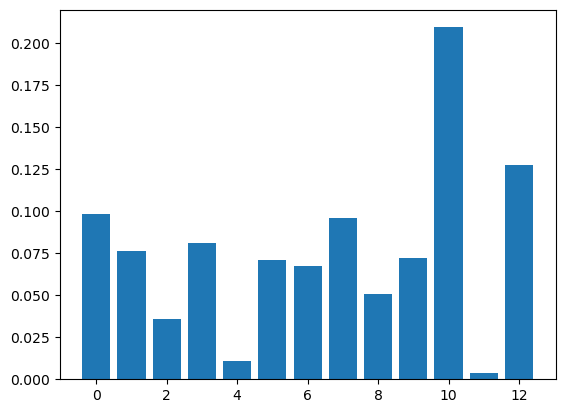

In [103]:
# get importance
importance = model_RF.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

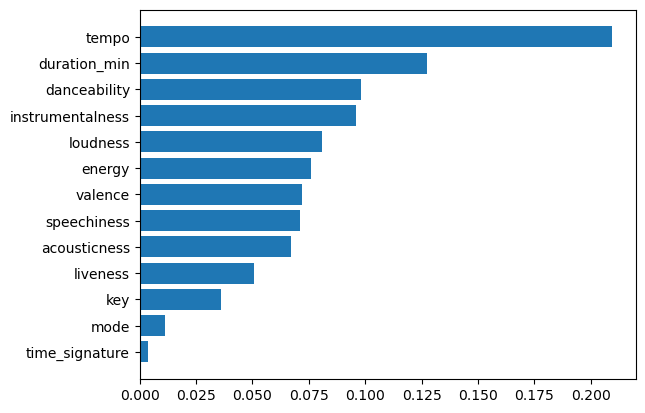

In [104]:
indices = np.argsort(importance)

fig, ax = plt.subplots()
ax.barh(range(len(importance)), importance[indices])
ax.set_yticks(range(len(importance)))
_ = ax.set_yticklabels(np.array(data_new.drop(columns=['genre','genre_enco']).columns)[indices])

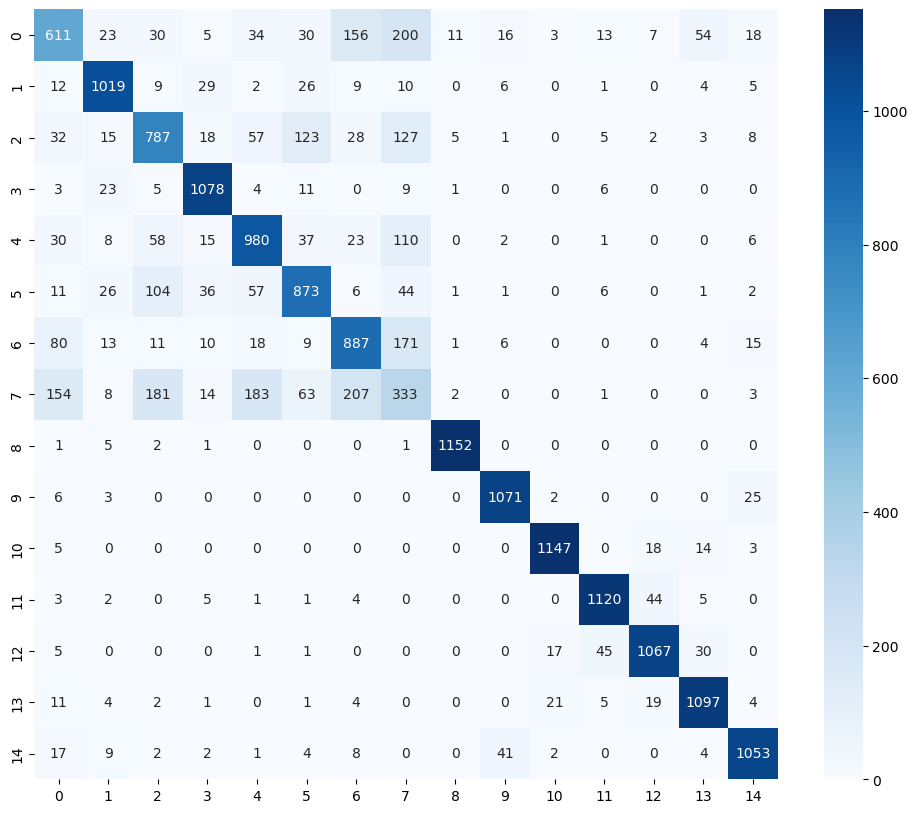

In [106]:
# y_pred = res_RF['predict']
cm = confusion_matrix(y_test, RF_pred)
fig = plt.subplots(figsize=(12, 10))
ax = sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")

In [105]:
print(classification_report(y_test, RF_pred))

              precision    recall  f1-score   support

           0       0.62      0.50      0.56      1211
           1       0.88      0.90      0.89      1132
           2       0.66      0.65      0.66      1211
           3       0.89      0.95      0.92      1140
           4       0.73      0.77      0.75      1270
           5       0.74      0.75      0.74      1168
           6       0.67      0.72      0.69      1225
           7       0.33      0.29      0.31      1149
           8       0.98      0.99      0.99      1162
           9       0.94      0.97      0.95      1107
          10       0.96      0.97      0.96      1187
          11       0.93      0.95      0.94      1185
          12       0.92      0.92      0.92      1166
          13       0.90      0.94      0.92      1169
          14       0.92      0.92      0.92      1143

    accuracy                           0.81     17625
   macro avg       0.81      0.81      0.81     17625
weighted avg       0.80   

### SVM

In [107]:
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score

k = 3

# Train Accuracy 
model_svc = SVC(kernel="rbf", C=1000, gamma="scale") 
cv_score = cross_val_score(model_svc, X_train, y_train, cv=k)
print('Cross_val Scores: ', cv_score)
print("Train Accuracy(average):", cv_score.mean()) 

# Test Accuracy
clf_svc = model_svc.fit(X_train, y_train)
SVM_pred = clf_svc.predict(X_test)
score_accuracy = accuracy_score(y_test, SVM_pred)
print("Test Accuracy:", score_accuracy)
scoring.append(['SVC', score_accuracy])

Cross_val Scores:  [0.79008511 0.79110638 0.78770213]
Train Accuracy(average): 0.7896312056737589
Test Accuracy: 0.8169078014184398


In [108]:
print(classification_report(y_test, SVM_pred))

              precision    recall  f1-score   support

           0       0.57      0.55      0.56      1211
           1       0.90      0.93      0.92      1132
           2       0.65      0.68      0.66      1211
           3       0.93      0.98      0.95      1140
           4       0.73      0.81      0.77      1270
           5       0.79      0.76      0.77      1168
           6       0.69      0.77      0.73      1225
           7       0.34      0.26      0.30      1149
           8       0.99      0.99      0.99      1162
           9       0.93      0.94      0.94      1107
          10       0.95      0.96      0.96      1187
          11       0.93      0.94      0.93      1185
          12       0.93      0.89      0.91      1166
          13       0.92      0.92      0.92      1169
          14       0.94      0.92      0.93      1143

    accuracy                           0.82     17625
   macro avg       0.81      0.82      0.81     17625
weighted avg       0.81   

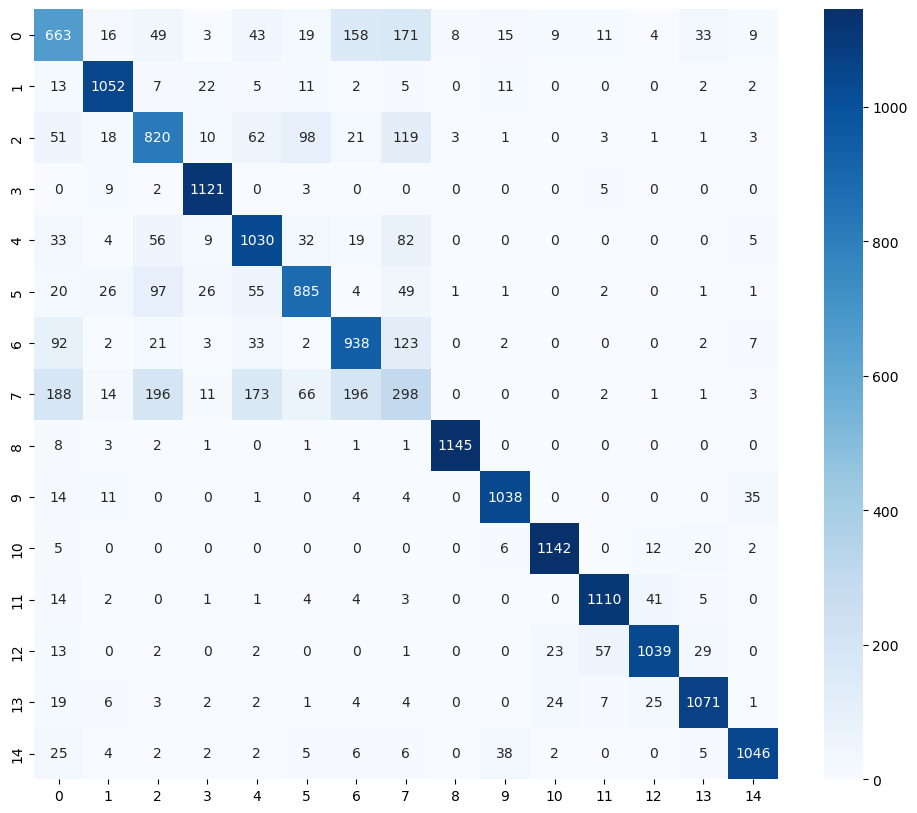

In [109]:
# import seaborn as sns; sns.set()
cm = confusion_matrix(y_test, SVM_pred)
fig = plt.subplots(figsize=(12, 10))
ax = sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")